In [1]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install geopandas

   ---------------------------------------- 0.0/16.2 MB ? eta -:--:--
   ---------------------------------------- 0.0/16.2 MB ? eta -:--:--
   ---------------------------------------- 0.0/16.2 MB ? eta -:--:--
    --------------------------------------- 0.3/16.2 MB ? eta -:--:--
   - -------------------------------------- 0.5/16.2 MB 840.2 kB/s eta 0:00:19
   - -------------------------------------- 0.8/16.2 MB 932.9 kB/s eta 0:00:17
   -- ------------------------------------- 1.0/16.2 MB 1.0 MB/s eta 0:00:15
   --- ------------------------------------ 1.3/16.2 MB 1.0 MB/s eta 0:00:15
   --- ------------------------------------ 1.6/16.2 MB 1.1 MB/s eta 0:00:14
   ---- ----------------------------------- 1.8/16.2 MB 1.1 MB/s eta 0:00:13
   ----- ---------------------------------- 2.1/16.2 MB 1.2 MB/s eta 0:00:12
   ----- ---------------------------------- 2.4/16.2 MB 1.2 MB/s eta 0:00:12
   ------- -------------------------------- 2.9/16.2 MB 1.2 MB/s eta 0:00:11
   ------- ------------

In [3]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


# Import Libraries

In [5]:
pip install kagglehub

Note: you may need to restart the kernel to use updated packages.


In [6]:
# System libraries
import re
import string
import unicodedata
import itertools
from collections import Counter
from IPython.display import display, Latex

# Data Handeling Libraries
import numpy as np
from scipy import stats
from scipy.optimize import curve_fit
import pandas as pd
import datetime as dt

# Data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio


# Regression and Machine Learning Libraries and Metrics
from sklearn.impute import SimpleImputer as SI
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import statsmodels.api as sm
import statsmodels.formula.api as smf

import warnings
warnings.filterwarnings("ignore")

# Connection Libraries
import kagglehub
from kagglehub import KaggleDatasetAdapter
import os

# Python version
from platform import python_version
print('Python version in this Jupyter Notebook:', python_version())


Python version in this Jupyter Notebook: 3.12.3


In [63]:
# Download dataset
dataset_path = kagglehub.dataset_download(
    "berkeleyearth/climate-change-earth-surface-temperature-data"
)

# Construct file path
csv_file_path = f"{dataset_path}/GlobalLandTemperaturesByCity.csv"

# Load CSV with encoding handling
df = pd.read_csv(csv_file_path, encoding="latin-1")  # Try 'utf-8' if this still fails

# Display first few rows
print(df.head())

           dt  AverageTemperature  AverageTemperatureUncertainty    City  \
0  1743-11-01               6.068                          1.737  Ãrhus   
1  1743-12-01                 NaN                            NaN  Ãrhus   
2  1744-01-01                 NaN                            NaN  Ãrhus   
3  1744-02-01                 NaN                            NaN  Ãrhus   
4  1744-03-01                 NaN                            NaN  Ãrhus   

   Country Latitude Longitude  
0  Denmark   57.05N    10.33E  
1  Denmark   57.05N    10.33E  
2  Denmark   57.05N    10.33E  
3  Denmark   57.05N    10.33E  
4  Denmark   57.05N    10.33E  


In [12]:
df

,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1743-11-01,6.068,1.737,Ã rhus,Denmark,57.05N,10.33E
1,1743-12-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
2,1744-01-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
3,1744-02-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
4,1744-03-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
...,...,...,...,...,...,...,...
8599207,2013-05-01,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E
8599208,2013-06-01,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E
8599209,2013-07-01,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E
8599210,2013-08-01,18.025,0.298,Zwolle,Netherlands,52.24N,5.26E


# Data Processing

## Data Summary

In [13]:
df

,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1743-11-01,6.068,1.737,Ã rhus,Denmark,57.05N,10.33E
1,1743-12-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
2,1744-01-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
3,1744-02-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
4,1744-03-01,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E
...,...,...,...,...,...,...,...
8599207,2013-05-01,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E
8599208,2013-06-01,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E
8599209,2013-07-01,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E
8599210,2013-08-01,18.025,0.298,Zwolle,Netherlands,52.24N,5.26E


In [14]:
df.isnull().sum()

dt                                    0
AverageTemperature               364130
AverageTemperatureUncertainty    364130
City                                  0
Country                               0
Latitude                              0
Longitude                             0
dtype: int64

In [15]:
df.describe()

,AverageTemperature,AverageTemperatureUncertainty
count,8.235082e+06,8.235082e+06
mean,1.672743e+01,1.028575e+00
std,1.035344e+01,1.129733e+00
min,-4.270400e+01,3.400000e-02
25%,1.029900e+01,3.370000e-01
50%,1.883100e+01,5.910000e-01
75%,2.521000e+01,1.349000e+00
max,3.965100e+01,1.539600e+01


In [16]:
df.describe(include='O')

,dt,City,Country,Latitude,Longitude
count,8599212,8599212,8599212,8599212,8599212
unique,3239,3448,159,73,1227
top,2013-09-01,Springfield,India,36.17N,139.23E
freq,3510,9545,1014906,425455,129600


## Seperating Date and Coordinatess

In [17]:
df['dt'] = pd.to_datetime(df['dt'])

df_dateset = df.copy()
df_dateset['year'] = df['dt'].dt.year
df_dateset['month'] = df['dt'].dt.month
df_dateset['day'] = df['dt'].dt.day

df_dateset.drop(columns=['dt'], inplace=True)

In [18]:
df_dateset

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,year,month,day
0,6.068,1.737,Ã rhus,Denmark,57.05N,10.33E,1743,11,1
1,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1743,12,1
2,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1744,1,1
3,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1744,2,1
4,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1744,3,1
...,...,...,...,...,...,...,...,...,...
8599207,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E,2013,5,1
8599208,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E,2013,6,1
8599209,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E,2013,7,1
8599210,18.025,0.298,Zwolle,Netherlands,52.24N,5.26E,2013,8,1


In [19]:
df_dateset[['Latitude_Value', 'Latitude_Direction']] = df_dateset['Latitude'].str.extract(r'([0-9.]+)([NS])')
df_dateset[['Longitude_Value', 'Longitude_Direction']] = df_dateset['Longitude'].str.extract(r'([0-9.]+)([EW])')

df_dateset['Latitude_Value'] = pd.to_numeric(df_dateset['Latitude_Value'], errors='coerce')
df_dateset['Longitude_Value'] = pd.to_numeric(df_dateset['Longitude_Value'], errors='coerce')

In [20]:
df_dateset

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,year,month,day,Latitude_Value,Latitude_Direction,Longitude_Value,Longitude_Direction
0,6.068,1.737,Ã rhus,Denmark,57.05N,10.33E,1743,11,1,57.05,N,10.33,E
1,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1743,12,1,57.05,N,10.33,E
2,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1744,1,1,57.05,N,10.33,E
3,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1744,2,1,57.05,N,10.33,E
4,NaN,NaN,Ã rhus,Denmark,57.05N,10.33E,1744,3,1,57.05,N,10.33,E
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8599207,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E,2013,5,1,52.24,N,5.26,E
8599208,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E,2013,6,1,52.24,N,5.26,E
8599209,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E,2013,7,1,52.24,N,5.26,E
8599210,18.025,0.298,Zwolle,Netherlands,52.24N,5.26E,2013,8,1,52.24,N,5.26,E



## Handeling Missing Values

### 1. Remove Missing Values

In [21]:
df_remove_null = df_dateset.dropna()

In [22]:
df_remove_null.isnull().sum()

AverageTemperature               0
AverageTemperatureUncertainty    0
City                             0
Country                          0
Latitude                         0
Longitude                        0
year                             0
month                            0
day                              0
Latitude_Value                   0
Latitude_Direction               0
Longitude_Value                  0
Longitude_Direction              0
dtype: int64

In [23]:
df_remove_null

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,year,month,day,Latitude_Value,Latitude_Direction,Longitude_Value,Longitude_Direction
0,6.068,1.737,Ã rhus,Denmark,57.05N,10.33E,1743,11,1,57.05,N,10.33,E
5,5.788,3.624,Ã rhus,Denmark,57.05N,10.33E,1744,4,1,57.05,N,10.33,E
6,10.644,1.283,Ã rhus,Denmark,57.05N,10.33E,1744,5,1,57.05,N,10.33,E
7,14.051,1.347,Ã rhus,Denmark,57.05N,10.33E,1744,6,1,57.05,N,10.33,E
8,16.082,1.396,Ã rhus,Denmark,57.05N,10.33E,1744,7,1,57.05,N,10.33,E
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8599206,7.710,0.182,Zwolle,Netherlands,52.24N,5.26E,2013,4,1,52.24,N,5.26,E
8599207,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E,2013,5,1,52.24,N,5.26,E
8599208,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E,2013,6,1,52.24,N,5.26,E
8599209,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E,2013,7,1,52.24,N,5.26,E


### 2. Mean Imputation

In [ ]:
df_mean = df_dateset[df_dateset.Country == 'India'].copy(deep=True)
for city in df_mean['City'].unique():
  subset = df_mean.loc[df_mean['City'] == city,['AverageTemperature','AverageTemperatureUncertainty']]
  subset = SI(strategy='mean').fit_transform(subset)
  df_mean.loc[df_mean['City'] == city,['AverageTemperature','AverageTemperatureUncertainty']] = subset

### 3. Median Imputation

In [ ]:
df_median = df_dateset[df_dateset.Country == 'India'].copy(deep=True)
for city in df_median['City'].unique():
    subset = df_median.loc[df_median['City'] == city,['AverageTemperature','AverageTemperatureUncertainty']]
    subset = SI(strategy='median').fit_transform(subset)
    df_median.loc[df_median['City'] == city,['AverageTemperature','AverageTemperatureUncertainty']] = subset

### 4. KNN Imputation

In [ ]:
df_KNN = df_dateset[df_dateset.Country == 'India'].copy(deep=True)
df_KNN[['AverageTemperature', 'AverageTemperatureUncertainty']] = KNNImputer(n_neighbors=3).fit_transform(df_KNN[['AverageTemperature', 'AverageTemperatureUncertainty']])

In [ ]:
df_KNN.isnull().sum()

## Handeling Outliers

### 1. Using Inter-Quantile Range

In [24]:
def IQR_Outliers(df, variable):
    Q1 = df[variable].quantile(0.25)
    Q3 = df[variable].quantile(0.75)
    IQR = Q3 - Q1
    df_IQR = df[df[variable] > Q1-1.5*IQR][df[variable] < Q3+1.5*IQR]
    df_IQR.reset_index(drop=True, inplace=True)
    return df_IQR

In [25]:
df_IQR = IQR_Outliers(IQR_Outliers(df_remove_null, 'AverageTemperature'), 'AverageTemperatureUncertainty')

In [ ]:
df_IQR.shape
df_IQR

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,year,month,day,Latitude_Value,Latitude_Direction,Longitude_Value,Longitude_Direction
0,6.068,1.737,Århus,Denmark,57.05N,10.33E,1743,11,1,57.05,N,10.33,E
1,10.644,1.283,Århus,Denmark,57.05N,10.33E,1744,5,1,57.05,N,10.33,E
2,14.051,1.347,Århus,Denmark,57.05N,10.33E,1744,6,1,57.05,N,10.33,E
3,16.082,1.396,Århus,Denmark,57.05N,10.33E,1744,7,1,57.05,N,10.33,E
4,12.781,1.454,Århus,Denmark,57.05N,10.33E,1744,9,1,57.05,N,10.33,E
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7639321,7.710,0.182,Zwolle,Netherlands,52.24N,5.26E,2013,4,1,52.24,N,5.26,E
7639322,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E,2013,5,1,52.24,N,5.26,E
7639323,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E,2013,6,1,52.24,N,5.26,E
7639324,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E,2013,7,1,52.24,N,5.26,E


### 2. Using 6-sigma Technique

In [26]:
mu, sig = df_remove_null['AverageTemperature'].mean(), df_remove_null['AverageTemperature'].std()

df_6sigma = df_remove_null.loc[df_remove_null['AverageTemperature'] < mu+3*sig][df_remove_null['AverageTemperature'] < mu-3*sig]

In [27]:
print(f'Data Shape is transformed from {df_remove_null.shape} to  {df_6sigma.shape}')

Data Shape is transformed from (8235082, 13) to  (69745, 13)


This kind of Loss of Data is not acceptable so this method can't be used

# Exploratory Data Analysis

## Global Analysis

In [28]:
df_IQR['Latitude'] = df_IQR['Latitude_Value']*df_IQR['Latitude_Direction'].map({'N':1,'S':-1})
df_IQR['Longitude'] = df_IQR['Longitude_Value']*df_IQR['Longitude_Direction'].map({'E':1,'W':-1})

df_avg_temp = df_IQR.groupby(['Latitude', 'Longitude'])['AverageTemperature'].mean().reset_index()

fig = go.Figure(data=go.Scattergeo(
    lon=df_avg_temp['Longitude'],
    lat=df_avg_temp['Latitude'],
    text=df_avg_temp['AverageTemperature'].round(2).astype(str) + "°C",
    marker=dict(
        size=6,
        color=df_avg_temp['AverageTemperature'],
        colorscale='thermal',
        colorbar=dict(title="Avg Temp (°C)"),
    )
))

fig.update_layout(
    title="Global Average Temperature Distribution",
    geo=dict(
        showland=True,
        landcolor="rgb(230, 230, 230)",
        showocean=True,
        oceancolor="rgb(204, 238, 255)",
        projection=dict(type="orthographic"),
        showcountries=True,
    )
)

fig.show()

In [29]:
df_grouped = df_IQR.groupby(["year", "Country"], as_index=False)["AverageTemperature"].mean()

fig = px.choropleth(
    df_grouped,
    locations="Country",
    locationmode="country names",
    color="AverageTemperature",
    hover_name="Country",
    animation_frame="year",
    title="Global Temperature Change Over Time",
    color_continuous_scale=px.colors.sequential.Turbo,
    range_color=[max(df["AverageTemperature"].min(), -10), min(df["AverageTemperature"].max(), 40)],
)

fig.update_layout(
    geo=dict(
        showcoastlines=True,
        framewidth = 1,
        showland=True,
        landcolor="rgb(240, 240, 240)",
        projection_type="natural earth1"
    ),
    coloraxis_colorbar=dict(title="Avg Temp (°C)")
)

pio.show(fig)

In [30]:
df_3d = df_IQR.copy()

df_3d = df_3d[df_3d["Latitude_Value"] > 0]

df_sampled = df_3d.sample(n=5000, random_state=42)

fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=df_sampled["year"],
    y=df_sampled["Latitude_Value"],
    z=df_sampled["AverageTemperature"],
    mode="markers",
    marker=dict(
        size=3,
        color=df_sampled["AverageTemperature"],
        colorscale="Viridis",
        opacity=0.8,
        colorbar=dict(title="Avg Temp (°C)")
    ),
    text=df_sampled["City"]
))

fig.update_layout(
    title="3D Plot of Temperature Variation (Positive Latitudes)",
    scene=dict(
        xaxis=dict(title="Year"),
        yaxis=dict(title="Latitude"),
        zaxis=dict(title="Avg Temperature (°C)"),
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

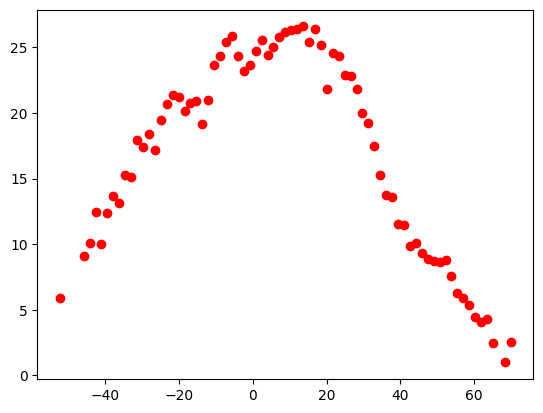

In [31]:
df_latplot = df_IQR.copy()

df_latplot['Latitude'] = df_latplot['Latitude_Value'] * df_latplot['Latitude_Direction'].map({'N': 1, 'S': -1})

df_grouped = df_latplot.groupby(["Latitude"], as_index=False)["AverageTemperature"].mean()

plt.plot(df_grouped['Latitude'], df_grouped['AverageTemperature'], 'ro')

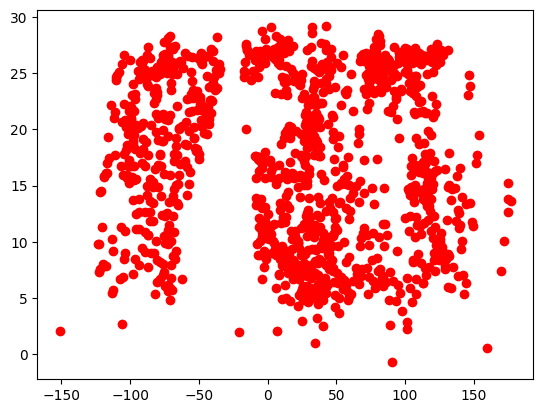

In [32]:
df_longplot = df_IQR.copy()

df_longplot['Longitude'] = df_longplot['Longitude_Value'] * df_longplot['Longitude_Direction'].map({'E': 1, 'W': -1})

df_grouped = df_longplot.groupby(["Longitude"], as_index=False)["AverageTemperature"].mean()

plt.plot(df_grouped['Longitude'], df_grouped['AverageTemperature'], 'ro')

<Axes: xlabel='year', ylabel='AverageTemperature'>

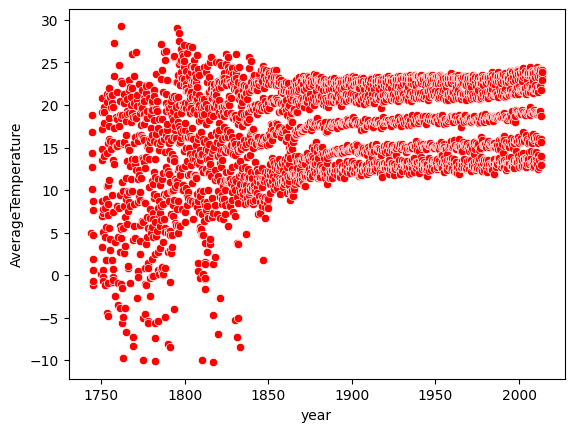

In [33]:
df_yearplot = df_IQR.copy()
df_yearplot['year'] = df_yearplot['year'] + df_yearplot['month']/12

df_grouped = df_yearplot.groupby(["year"], as_index=False)["AverageTemperature"].mean()

#plt.plot(df_grouped['year'], df_grouped['AverageTemperature'], 'ro')
sns.scatterplot(x='year',y ='AverageTemperature',data=df_grouped, color='red')

## Indian Data

In [34]:
India = df_IQR[df_IQR['Country'] == "India"].reset_index(drop=True)
India

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,year,month,day,Latitude_Value,Latitude_Direction,Longitude_Value,Longitude_Direction
0,19.934,2.258,Abohar,India,29.74,73.85,1816,3,1,29.74,N,73.85,E
1,32.535,2.408,Abohar,India,29.74,73.85,1816,5,1,29.74,N,73.85,E
2,33.254,2.123,Abohar,India,29.74,73.85,1816,6,1,29.74,N,73.85,E
3,31.105,1.848,Abohar,India,29.74,73.85,1816,7,1,29.74,N,73.85,E
4,30.429,1.453,Abohar,India,29.74,73.85,1816,8,1,29.74,N,73.85,E
...,...,...,...,...,...,...,...,...,...,...,...,...,...
931826,29.800,0.375,Yelahanka,India,13.66,76.79,2013,4,1,13.66,N,76.79,E
931827,29.286,0.516,Yelahanka,India,13.66,76.79,2013,5,1,13.66,N,76.79,E
931828,25.401,0.400,Yelahanka,India,13.66,76.79,2013,6,1,13.66,N,76.79,E
931829,24.232,0.323,Yelahanka,India,13.66,76.79,2013,7,1,13.66,N,76.79,E


In [35]:
import folium
from folium.plugins import HeatMap

filtered_data = India.groupby(["Latitude", "Longitude"])["AverageTemperature"].mean().reset_index()
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)
HeatMap(filtered_data[['Latitude', 'Longitude', 'AverageTemperature']].values, radius=10).add_to(m)

m


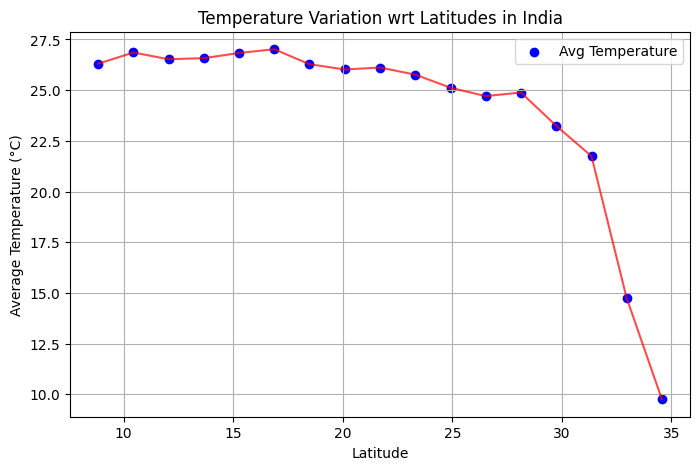

In [36]:
avtp = India.groupby('Latitude_Value')['AverageTemperature'].mean()

plt.figure(figsize=(8, 5))
plt.scatter(avtp.index, avtp.values, color='b', label="Avg Temperature")
plt.plot(avtp.index, avtp.values, linestyle='-', color='r', alpha=0.7)
plt.xlabel("Latitude")
plt.ylabel("Average Temperature (°C)")
plt.title("Temperature Variation wrt Latitudes in India")
plt.legend()
plt.grid(True)
plt.show()

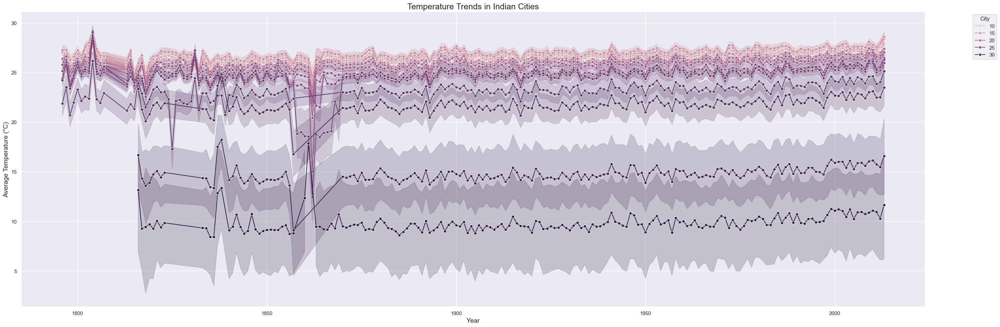

In [37]:
plt.figure(figsize=(30, 10))
sns.set_theme(style="darkgrid")
sns.lineplot(data=India, x='year', y='AverageTemperature', hue='Latitude_Value', marker='o')
plt.title('Temperature Trends in Indian Cities', fontsize=18)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Average Temperature (°C)', fontsize=14)
plt.legend(title='City', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

plt.tight_layout()
plt.show()

In [39]:
def get_season(month):
    if month in [3, 4]:
        return 'Vasanta'
    elif month in [5, 6]:
        return 'Grishma'
    elif month in [7, 8]:
        return 'Varsha'
    elif month in [9, 10]:
        return 'Sharada'
    elif month in [11, 12]:
        return 'Hemanta'
    elif month in [1, 2]:
        return 'Shishira'



India['Season'] = India['month'].apply(get_season)
India

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,year,month,day,Latitude_Value,Latitude_Direction,Longitude_Value,Longitude_Direction,Season
0,19.934,2.258,Abohar,India,29.74,73.85,1816,3,1,29.74,N,73.85,E,Vasanta
1,32.535,2.408,Abohar,India,29.74,73.85,1816,5,1,29.74,N,73.85,E,Grishma
2,33.254,2.123,Abohar,India,29.74,73.85,1816,6,1,29.74,N,73.85,E,Grishma
3,31.105,1.848,Abohar,India,29.74,73.85,1816,7,1,29.74,N,73.85,E,Varsha
4,30.429,1.453,Abohar,India,29.74,73.85,1816,8,1,29.74,N,73.85,E,Varsha
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
931826,29.800,0.375,Yelahanka,India,13.66,76.79,2013,4,1,13.66,N,76.79,E,Vasanta
931827,29.286,0.516,Yelahanka,India,13.66,76.79,2013,5,1,13.66,N,76.79,E,Grishma
931828,25.401,0.400,Yelahanka,India,13.66,76.79,2013,6,1,13.66,N,76.79,E,Grishma
931829,24.232,0.323,Yelahanka,India,13.66,76.79,2013,7,1,13.66,N,76.79,E,Varsha


In [40]:
season_mapping = {
    "Vasanta": 3, "Grishma": 1, "Varsha": 2,
    "Sharad": 4, "Hemanta": 5, "Shishira": 6
}

ind_3d = India.copy(deep=True)

ind_3d["season_value"] = ind_3d["Season"].map(season_mapping)

years = np.linspace(ind_3d["year"].min(), ind_3d["year"].max(), num=5000, dtype=int)

ind_sampled = ind_3d[India["year"].isin(years)]


if len(ind_sampled) > 5000:
    ind_sampled = ind_sampled.sample(n=5000, random_state=42)


fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=ind_sampled["year"],
    y=ind_sampled["Latitude_Value"],
    z=ind_sampled["AverageTemperature"],
    mode="markers",
    marker=dict(
        size=3,
        color=ind_sampled["season_value"],  # 🔹 Color by season
        #colorscale="vlag",
        opacity=0.8,
        colorbar=dict(title="Season")
    ),
    text=ind_sampled["City"]
))


fig.update_layout(
    title="3D Temperature Variation in India (By Season)",
    scene=dict(
        xaxis=dict(title="Year"),
        yaxis=dict(title="Latitude"),
        zaxis=dict(title="Avg Temperature (°C)"),
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

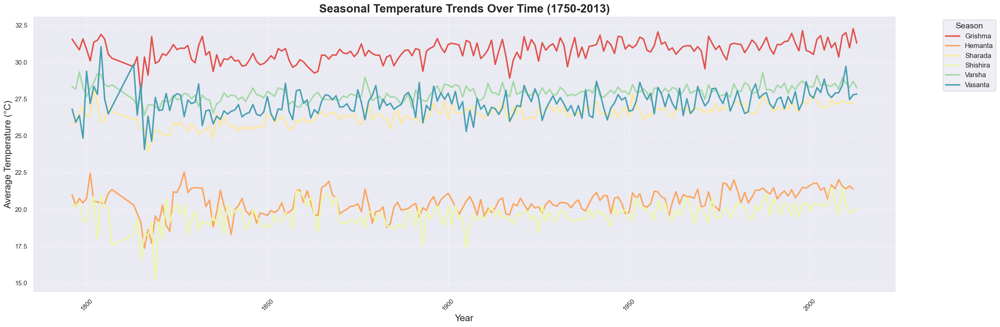

In [41]:
seasonal_temp_trend = India.groupby(['year', 'Season'])['AverageTemperature'].mean().reset_index()

plt.figure(figsize=(24, 8))
sns.lineplot(
    data=seasonal_temp_trend,
    x='year',
    y='AverageTemperature',
    hue='Season',
    palette='Spectral',
    linewidth=2.5
)

plt.title('Seasonal Temperature Trends Over Time (1750-2013)', fontsize=20, fontweight='bold')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Average Temperature (°C)', fontsize=16)
plt.legend(title='Season', fontsize=12, title_fontsize=14, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

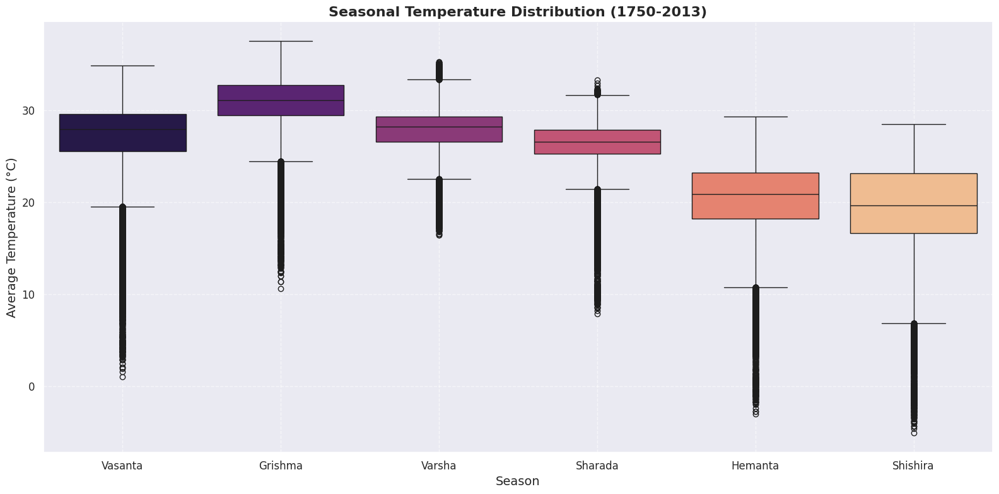

In [ ]:
seasonal_avg_temp = India.groupby(['Season'])['AverageTemperature'].mean().reset_index()

plt.figure(figsize=(16, 8))
sns.boxplot(data=India, x='Season', y='AverageTemperature', hue = "Season",palette='magma')

plt.title('Seasonal Temperature Distribution (1750-2013)', fontsize=16, fontweight='bold')
plt.xlabel('Season', fontsize=14)
plt.ylabel('Average Temperature (°C)', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

plt.show()

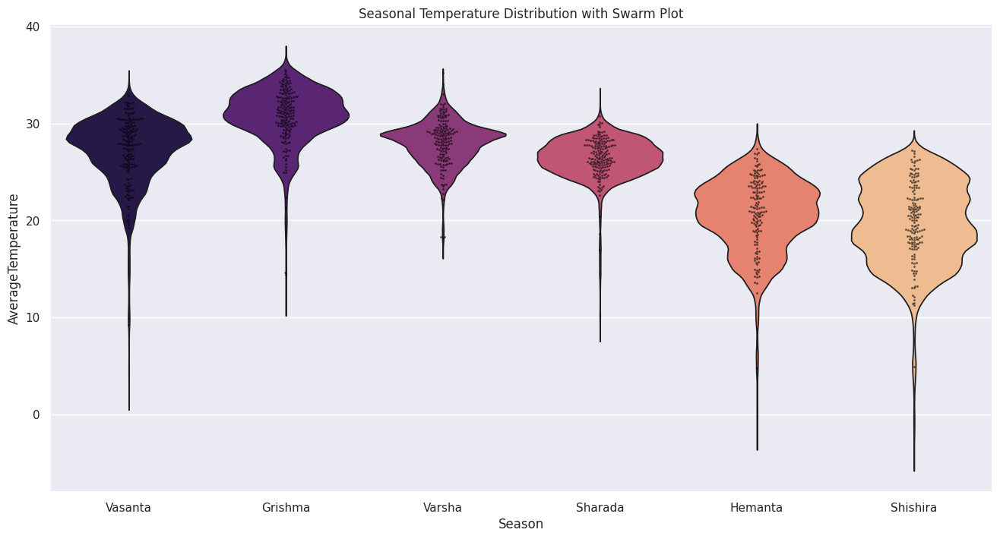

In [ ]:
plt.figure(figsize=(16, 8))
sns.violinplot(data=India, x='Season', y='AverageTemperature', palette='magma', inner=None)
sns.swarmplot(data=India.sample(n=1000,random_state = 64), x='Season', y='AverageTemperature', color='black', size=2, alpha=0.6)
plt.title('Seasonal Temperature Distribution with Swarm Plot')
plt.show()
# takes hell lot of time

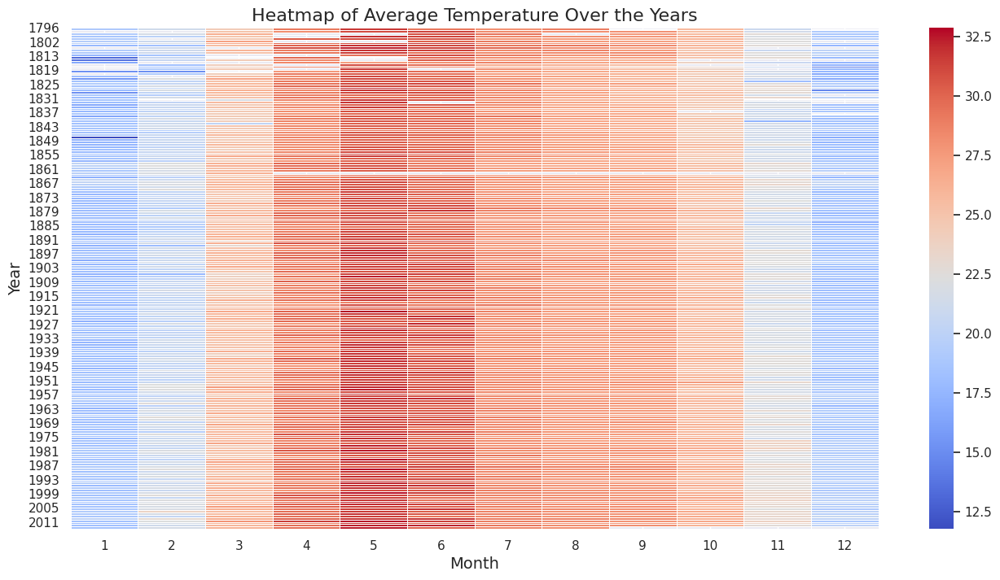

In [ ]:
heatmap_data = India.pivot_table(index="year", columns="month", values="AverageTemperature", aggfunc="mean")

plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_data, cmap="coolwarm", linewidths=0.5)
plt.title("Heatmap of Average Temperature Over the Years", fontsize=16)
plt.xlabel("Month", fontsize=14)
plt.ylabel("Year", fontsize=14)
plt.show()

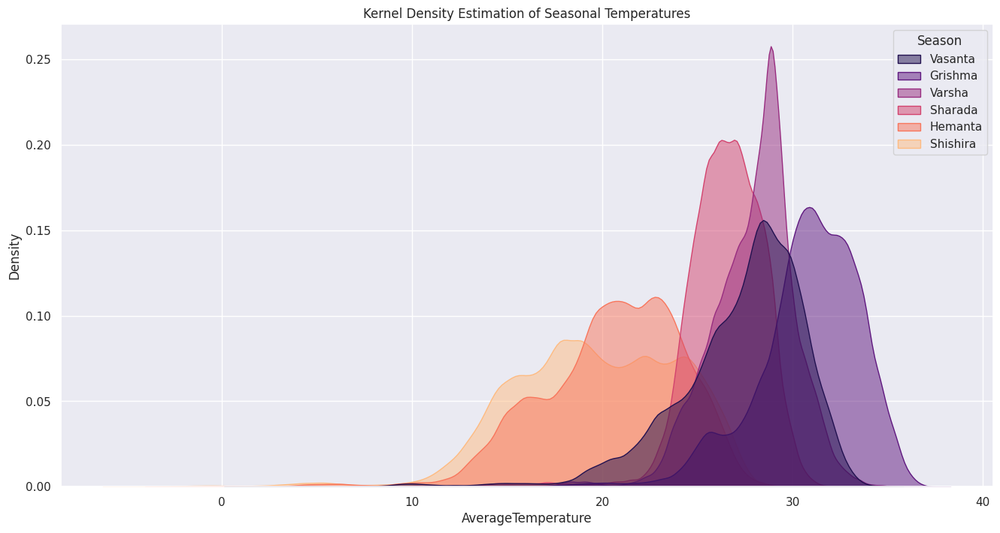

In [ ]:
plt.figure(figsize=(16, 8))
sns.kdeplot(data=India, x='AverageTemperature', hue='Season', fill=True, common_norm=False, palette='magma', alpha=0.5)
plt.title('Kernel Density Estimation of Seasonal Temperatures')
plt.show()


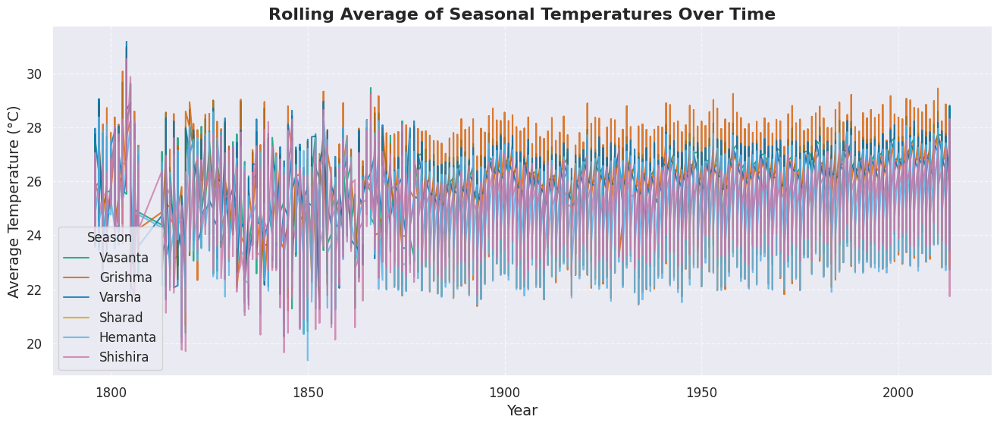

In [ ]:
India_sampled = India.groupby("year").apply(lambda x: x.sample(n=min(100, len(x)), random_state=42)).reset_index(drop=True)

India_sampled["rolling_avg"] = India_sampled["AverageTemperature"].rolling(window=12, min_periods=1).mean()

color = {
    "Vasanta": "#009E73",  # Green
    "Grishma": "#D55E00",  # Orange
    "Varsha": "#0072B2",   # Blue
    "Sharad": "#E69F00",   # Yellow
    "Hemanta": "#56B4E9",  # Light Blue
    "Shishira": "#CC79A7"  # Purple
}

plt.figure(figsize=(16, 6))
for season, col in color.items():
    subset = India_sampled[India_sampled["Season"] == season]
    plt.plot(subset["year"], subset["rolling_avg"], label=season, color=col, alpha=0.8, linewidth=1.5)

plt.legend(title="Season", fontsize=12)
plt.xlabel("Year", fontsize=14)
plt.ylabel("Average Temperature (°C)", fontsize=14)
plt.title("Rolling Average of Seasonal Temperatures Over Time", fontsize=16, fontweight="bold")
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()


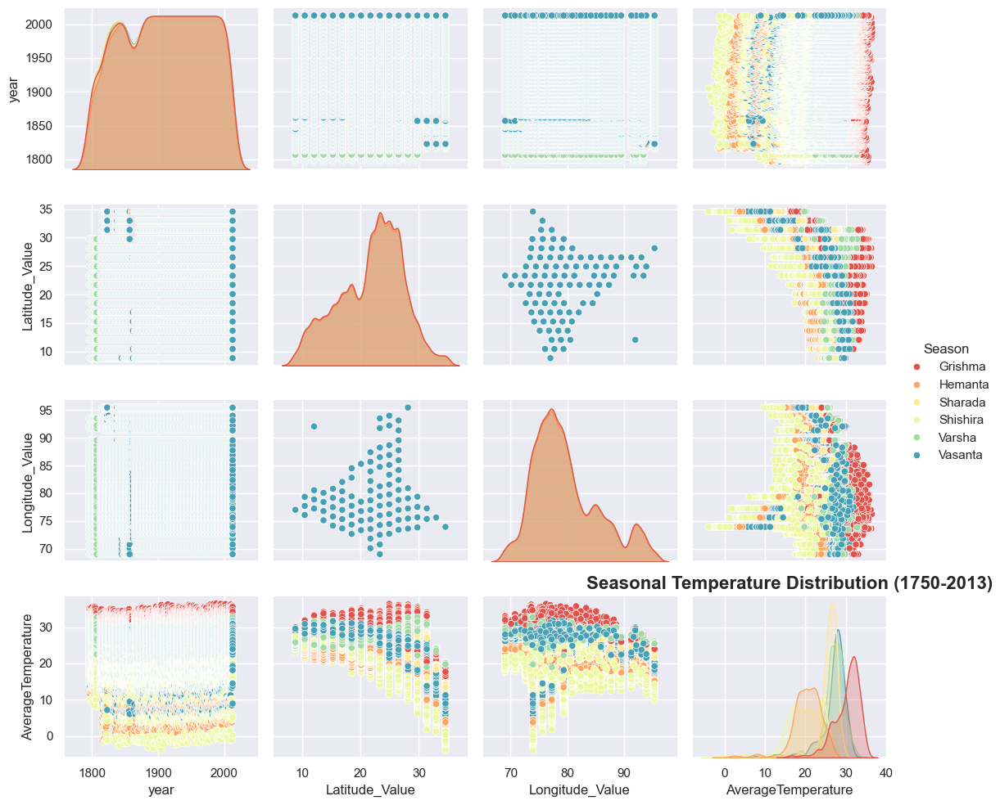

In [42]:
seasonal_temp_trend_lat = India.groupby(['year', 'Season', 'Latitude_Value','Longitude_Value'])['AverageTemperature'].mean().reset_index()
sns.pairplot(data=seasonal_temp_trend_lat,hue = 'Season', palette='Spectral')

plt.title('Seasonal Temperature Distribution (1750-2013)', fontsize=16, fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

plt.show()

# Data Pre-Processing for Regression

In [43]:
def preprocessing(df_processing):
    df_processing['dt'] = pd.to_datetime(df_processing['dt'])
    df_processing['year'] = df_processing['dt'].dt.year
    df_processing['month'] = df_processing['dt'].dt.month
    df_processing['day'] = df_processing['dt'].dt.day # Setting the Date, month, and Year
    df_processing[['Latitude_Value', 'Latitude_Direction']] = df_processing['Latitude'].str.extract(r'([0-9.]+)([NS])') # Separating Direction and Values
    df_processing[['Longitude_Value', 'Longitude_Direction']] = df_processing['Longitude'].str.extract(r'([0-9.]+)([EW])')
    df_processing['Latitude_Value'] = pd.to_numeric(df_processing['Latitude_Value'], errors='coerce') # Writing value as numeric
    df_processing['Longitude_Value'] = pd.to_numeric(df_processing['Longitude_Value'], errors='coerce')
    # def get_season(month):
    #     if month in [2,3,4,5]:
    #         return 'Summer'
    #     elif month in [6,7,8,9]:
    #         return 'Monsoon'
    #     elif month in [10,11,12,1]:
    #         return 'Winter'
    df_processing = df_processing.dropna() # Dropping Null Values
    df_processing = IQR_Outliers(IQR_Outliers(df_processing, 'AverageTemperature'), 'AverageTemperatureUncertainty')
    cols_to_drop = ['Latitude', 'Longitude', 'dt']
    df_processing = df_processing.drop(columns=cols_to_drop) # Dropping unwanted columns
    # df_processing.loc[:,'season'] = df_processing['month'].apply(get_season) # Creating Seasons from the data
    df_processing.reset_index(drop=True, inplace=True) # Reset the Index
    df_processing['year'] = df_processing['year'] + df_processing['month'] / 12 # Form with fractional part
    df_processing = df_processing.drop(columns=['month', 'day']) # Removing unwanted Columns
    df_processing['Latitude_Value'] = np.where(df_processing['Latitude_Direction'] == 'N', df_processing['Latitude_Value'], -df_processing['Latitude_Value'])
    df_processing['Longitude_Value'] = np.where(df_processing['Longitude_Direction'] == 'E', df_processing['Longitude_Value'], -df_processing['Longitude_Value']) # Getting latitude and longitude values from the directions
    df_processing.drop(columns=['Latitude_Direction', 'Longitude_Direction'], inplace=True)
    df_processing.rename(columns={'Latitude_Value': 'Latitude', 'Longitude_Value': 'Longitude'}, inplace=True)
    return df_processing  # Returning Dummies of season
df_processed = df.copy()
df_processed = preprocessing(df_processed)
df_processed

,AverageTemperature,AverageTemperatureUncertainty,City,Country,year,Latitude,Longitude
0,6.068,1.737,Ã rhus,Denmark,1743.916667,57.05,10.33
1,10.644,1.283,Ã rhus,Denmark,1744.416667,57.05,10.33
2,14.051,1.347,Ã rhus,Denmark,1744.500000,57.05,10.33
3,16.082,1.396,Ã rhus,Denmark,1744.583333,57.05,10.33
4,12.781,1.454,Ã rhus,Denmark,1744.750000,57.05,10.33
...,...,...,...,...,...,...,...
7639321,7.710,0.182,Zwolle,Netherlands,2013.333333,52.24,5.26
7639322,11.464,0.236,Zwolle,Netherlands,2013.416667,52.24,5.26
7639323,15.043,0.261,Zwolle,Netherlands,2013.500000,52.24,5.26
7639324,18.775,0.193,Zwolle,Netherlands,2013.583333,52.24,5.26


# Models

## Splitting into test and train data

In [44]:
df_train, df_test = train_test_split(df_processed, test_size=0.2, random_state=42)

## Scaling of data

In [ ]:
scaler = MinMaxScaler()
df_train_scaled =pd.DataFrame(scaler.fit_transform(df_train), columns=df_train.columns)
df_test_scaled = pd.DataFrame(scaler.fit_transform(df_test), columns=df_test.columns)

## Linear Regression in scikit-learn

In [45]:
from sklearn.linear_model import LinearRegression
from IPython.display import display, Latex

linear_model = LinearRegression()
fitted_model = linear_model.fit(df_train[['Latitude']], df_train['AverageTemperature'])

string = r"$ T = "

for c, x in zip(fitted_model.coef_, fitted_model.feature_names_in_):
    sign = "+" if c >= 0 else ""
    string += f"{sign}{c:.4f} * {x} "

intercept_sign = "+" if fitted_model.intercept_ >= 0 else ""
string += f"{intercept_sign}{fitted_model.intercept_:.4f} $"

string = string.replace('_', ' ')
print("The Fitted Model is:")
display(Latex(string))
print(f"R2 Score for training data: {fitted_model.score(df_train[['Latitude']], df_train['AverageTemperature']):.4f}")
print(f"R2 Score for test data: {fitted_model.score(df_test[['Latitude']], df_test['AverageTemperature']):.4f}")


The Fitted Model is:


<IPython.core.display.Latex object>

R2 Score for training data: 0.2198
R2 Score for test data: 0.2209


### Quadratic of Latitude

In [46]:
df_train['Latitude^2'] = df_train['Latitude']**2
df_test['Latitude^2'] = df_test['Latitude']**2
fitted_model = linear_model.fit(df_train[['Latitude', 'Latitude^2']], df_train['AverageTemperature'])

string='$ T = '
for c, x in zip(fitted_model.coef_, fitted_model.feature_names_in_):
    string += f"{c if c <0 else f'+{c}'}*{x}"
string += f'{fitted_model.intercept_ if fitted_model.intercept_ <0 else f'+{fitted_model.intercept_}'}$'

string = string.replace('_',' ')
print('The Fitted Model is,')
display(Latex(string))

print(f'R2_Score for this model on train data is, {fitted_model.score(df_train[['Latitude','Latitude^2']], df_train[['AverageTemperature']])}')
print(f'R2_Score for this model on test data is, {fitted_model.score(df_test[['Latitude', 'Latitude^2']], df_test[['AverageTemperature']])}')

The Fitted Model is,


<IPython.core.display.Latex object>

R2_Score for this model on train data is, 0.4537131396678693
R2_Score for this model on test data is, 0.45427622928863653


This is a considerable because as it was seen in the earlier graph there is dome formation here

### Including time variables

In [47]:
fitted_model = linear_model.fit(df_train[['Latitude', 'Latitude^2','year']], df_train['AverageTemperature'])

string='$ T = '
for c, x in zip(fitted_model.coef_, fitted_model.feature_names_in_):
    string += f"{c if c <0 else f'+{c}'}*{x}"
string += f'{fitted_model.intercept_ if fitted_model.intercept_ <0 else f'+{fitted_model.intercept_}'}$'

string = string.replace('_',' ')
print('The Fitted Model is,')
display(Latex(string))

print(f'R2_Score for this model on train data is, {fitted_model.score(df_train[['Latitude','Latitude^2','year']], df_train[['AverageTemperature']])}')
print(f'R2_Score for this model on test data is, {fitted_model.score(df_test[['Latitude', 'Latitude^2','year']], df_test[['AverageTemperature']])}')

The Fitted Model is,


<IPython.core.display.Latex object>

R2_Score for this model on train data is, 0.4537143991431247
R2_Score for this model on test data is, 0.45427681026824607


## Non-Linear Models

In [48]:
countries_with_100_cities = df_processed.groupby('Country')['City'].nunique()
countries_to_keep = countries_with_100_cities[countries_with_100_cities > 50].index
df_large_countries = df_processed[df_processed['Country'].isin(countries_to_keep)].copy()

In [54]:
df_train

,AverageTemperature,AverageTemperatureUncertainty,City,Country,year,Latitude,Longitude,Latitude^2
2154661,29.389,0.677,Funtua,Nigeria,1907.416667,12.05,6.58,145.2025
2731301,28.424,1.348,Humen,China,1853.666667,23.31,114.47,543.3561
3787625,22.893,0.380,Lichinga,Mozambique,1945.000000,-13.66,35.50,186.5956
6167469,-4.832,2.299,Sherbrooke,Canada,1818.250000,45.81,-72.69,2098.5561
1510127,15.566,0.783,Cochabamba,Bolivia,1911.083333,-16.87,-66.98,284.5969
...,...,...,...,...,...,...,...,...
1692743,20.245,1.137,Datong,China,1921.583333,40.99,112.90,1680.1801
6550634,20.927,0.489,Takasaki,Japan,2013.500000,36.17,139.23,1308.2689
6423388,23.690,0.644,Sumedang,Indonesia,1893.500000,-7.23,107.84,52.2729
6962611,4.930,0.899,Ube,Japan,1885.000000,34.56,130.38,1194.3936


In [61]:
def model(x,mu, sigma2, A,B,C,D, omega, phi):
  x = x.reset_index(drop=True)
  year = x['year']
  latitude = x['Latitude']

  Temperature = A*np.exp(-0.5*((latitude-mu)**2/sigma2)) + B*np.sin(omega*year + phi) + C*year + D

  return Temperature

In [74]:
mu = df['AverageTemperature'].mean()
sig = df['AverageTemperature'].std()
mu, sig

(16.72743263625063, 10.353442482534406)

In [89]:
initial_guess = [mu, sig, 5, 15, 1, 10, 2 * np.pi / 10, 0]

In [94]:
params, _ = curve_fit(model, df_train[['year', 'Latitude']], df_train['AverageTemperature'], p0=initial_guess)

In [97]:
mu, sigma2, A, B, C, D, omega, phi = params
print(f"Fitted Parameters:\n mu={mu}, sigma2={sigma2}, A={A}, B={B}, C={C}, D={D}, omega={omega}, phi={phi}")

Fitted Parameters:
 mu=2.8959691443493147, sigma2=1115.592421205203, A=29.912204330243533, B=0.048024258165883495, C=-8.235290224036856e-05, D=-2.5813633821754953, omega=0.5626639712503344, phi=113.46372618442798


In [100]:
fitted_test_model = model( df_test.drop(columns=['AverageTemperature', 'AverageTemperatureUncertainty']), *params)

ss_total = np.sum((df_test['AverageTemperature'] - df_test['AverageTemperature'].mean()) ** 2)
ss_residual = np.sum((df_test['AverageTemperature'] - fitted_test_model) ** 2)
r_squared = 1 - (ss_residual / ss_total)

print(ss_total)
print(ss_residual)
print(r_squared)

137758514.548981
39329573.8136406
0.7145034995302835


In [102]:
xx = df_test['AverageTemperature']
yy = model(df_test[['year','Latitude']], *params)

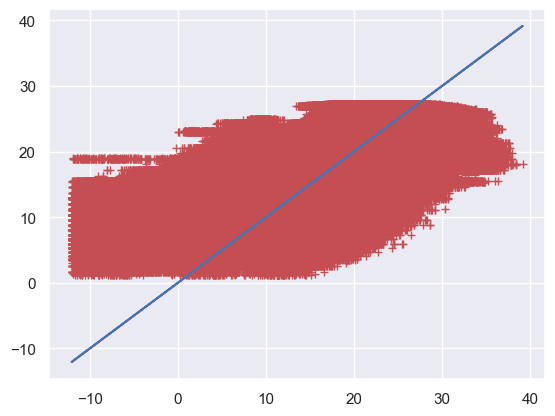

In [103]:
plt.plot(xx, yy, 'r+')
plt.plot(xx, xx, 'b-')

In [117]:
def model(x, A, B, C, D, E, G, omega, phi, mu=16.7, sigma2=10.3):
    Year = x['year']
    Latitude = x['Latitude']

    return (A * np.exp(-0.5 * ((Latitude - mu) ** 2 / sigma2)) +  # Latitude effect
            B * np.sin(omega * Year + phi) +  # Seasonal variation
            C * np.log(Year - D) +  # Logarithmic long-term trend
            G * (90 - np.abs(Latitude)) ** 2 +  # Quadratic effect
            E)  # Offset

In [118]:

params, _ = curve_fit(model, df_train.drop(columns=['AverageTemperature', 'AverageTemperatureUncertainty']), df_train['AverageTemperature'], p0= [30,5,1,-3,2,6,100,-10])


In [119]:
fitted_train_model = model( df_train.drop(columns=['AverageTemperature', 'AverageTemperatureUncertainty']), *params)
fitted_test_model = model( df_test.drop(columns=['AverageTemperature', 'AverageTemperatureUncertainty']), *params)

In [120]:
ss_total = np.sum((df_test['AverageTemperature'] - df_test['AverageTemperature'].mean()) ** 2)
ss_residual = np.sum((df_test['AverageTemperature'] - fitted_test_model) ** 2)
r_squared = 1 - (ss_residual / ss_total)

print(f'R2 for this fit is {r_squared}')

print(f'Given that the parameters are{params}')

R2 for this fit is 0.42956705919941485
Given that the parameters are[ 4.59165437e+00  1.58714341e-02  7.13094245e+00 -1.05119566e+04
 -6.21875269e+01  3.19966242e-03  1.00001887e+02 -1.23309137e+01]


In [122]:
A, B, C, D, E, G, omega, phi = params
A, B, C, D, E, G, omega, phi

(4.591654371789693,
 0.01587143407371072,
 7.130942454372721,
 -10511.956560741073,
 -62.18752694302542,
 0.0031996624202720813,
 100.00188659375705,
 -12.330913711180468)

In [59]:
xx = df_test['AverageTemperature']
yy = model(df_test[['year','Latitude']], *params)

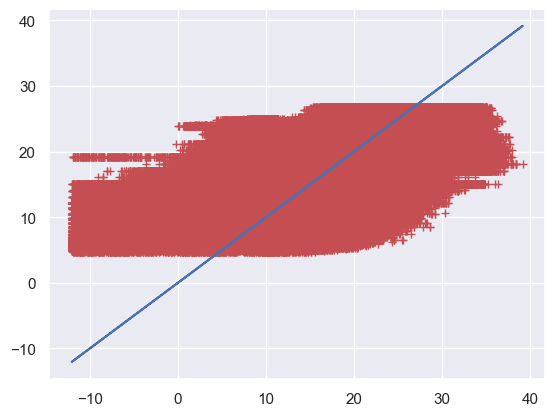

In [60]:
plt.plot(xx, yy, 'r+')
plt.plot(xx, xx, 'b-')

In [124]:
df_processed['sin_year'] = E+ B * np.sin(omega  * df_processed['year'] + phi)
df_processed['quad_lat'] = G*(90-np.abs(df_processed['Latitude']))**2
df_processed['bell_lat'] = A * np.exp(-0.5 * ((df_processed['Latitude'] - mu) ** 2 / sigma2))
df_processed['log_year'] = C * np.log(df_processed['year'] - D)

In [129]:
df_filtered = df_processed[(df_processed["year"] > 1850) & (df_processed["year"] < 2000)].copy()
df_train, df_test = train_test_split(df_filtered, test_size=0.2, random_state=42)

In [130]:
fitted_model = linear_model.fit(df_train[['Latitude', 'sin_year','quad_lat','bell_lat','log_year','year']], df_train['AverageTemperature'])

string='$ T = '
for c, x in zip(fitted_model.coef_, fitted_model.feature_names_in_):
    string += f"{c if c <0 else f'+{c}'}*{x}"
string += f'{fitted_model.intercept_ if fitted_model.intercept_ <0 else f'+{fitted_model.intercept_}'}$'

string = string.replace('_',' ')
print('The Fitted Model is,')
display(Latex(string))

print(f'R2_Score for this model on train data is, {fitted_model.score(df_train[['Latitude', 'sin_year','quad_lat','bell_lat','log_year','year']], df_train[['AverageTemperature']])}')
print(f'R2_Score for this model on test data is, {fitted_model.score(df_test[['Latitude', 'sin_year','quad_lat','bell_lat','log_year','year']], df_test[['AverageTemperature']])}')

The Fitted Model is,


<IPython.core.display.Latex object>

R2_Score for this model on train data is, 0.47960514291286294
R2_Score for this model on test data is, 0.4791654973981646


In [142]:
year_grid = np.linspace(df_filtered['year'].min(), df_filtered['year'].max(), 50)
latitude_grid = np.linspace(df_filtered['Latitude'].min(),df_filtered['Latitude'].max(), 50)
year_mesh, latitude_mesh = np.meshgrid(year_grid, latitude_grid)
x = np.stack((year_mesh.ravel(), latitude_mesh.ravel()), axis=1)
x

array([[1850.08333333,  -52.24      ],
       [1853.14115646,  -52.24      ],
       [1856.19897959,  -52.24      ],
       ...,
       [1993.80102041,   69.92      ],
       [1996.85884354,   69.92      ],
       [1999.91666667,   69.92      ]])

In [143]:
x = pd.DataFrame(x, columns = ['year','Latitude'])
x

,year,Latitude
0,1850.083333,-52.24
1,1853.141156,-52.24
2,1856.198980,-52.24
3,1859.256803,-52.24
4,1862.314626,-52.24
...,...,...
2495,1987.685374,69.92
2496,1990.743197,69.92
2497,1993.801020,69.92
2498,1996.858844,69.92


In [146]:
z_surface = model(x, *params)

z_surface

0       9.557127
1       9.582733
2       9.560902
3       9.562155
4       9.588016
          ...   
2495    6.360485
2496    6.388946
2497    6.372043
2498    6.365509
2499    6.394084
Length: 2500, dtype: float64

In [149]:
z_surface = pd.DataFrame(z_surface,columns = ['AverageTemperature'])
z_surface

,AverageTemperature
0,9.557127
1,9.582733
2,9.560902
3,9.562155
4,9.588016
...,...
2495,6.360485
2496,6.388946
2497,6.372043
2498,6.365509


In [152]:
fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=df_sampled["year"], y=df_sampled["Latitude"], z=df_sampled["AverageTemperature"],
    mode="markers", marker=dict(size=3, color=df_sampled["AverageTemperature"],
                                  colorscale="Viridis", opacity=0.8, colorbar=dict(title="Avg Temp (°C)")),
    text=df_sampled["City"], name="Scatter Data"
))

fig.add_trace(go.Surface(x=year_grid, y=latitude_grid, z=z_surface.values, colorscale="Viridis", opacity=0.6))

fig.update_layout(
    title="3D Scatter Plot with Fitted Temperature Surface",
    scene=dict(
        xaxis=dict(title="Year"),
        yaxis=dict(title="Latitude"),
        zaxis=dict(title="Avg Temperature (°C)"),
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

### Random forest

In [154]:
X = df_processed[(df_processed["year"] > 1850)][["AverageTemperatureUncertainty", "year", "Latitude"]]
y = df_processed[(df_processed["year"] > 1850)]["AverageTemperature"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X,y,X_train, X_test, y_train, y_test

(         AverageTemperatureUncertainty         year  Latitude
 555                              1.820  1850.083333     57.05
 556                              1.641  1850.166667     57.05
 557                              1.903  1850.333333     57.05
 558                              0.586  1850.416667     57.05
 559                              1.023  1850.500000     57.05
 ...                                ...          ...       ...
 7639321                          0.182  2013.333333     52.24
 7639322                          0.236  2013.416667     52.24
 7639323                          0.261  2013.500000     52.24
 7639324                          0.193  2013.583333     52.24
 7639325                          0.298  2013.666667     52.24
 
 [6629269 rows x 3 columns],
 555        -5.265
 556         1.859
 557         5.764
 558        11.037
 559        15.299
             ...  
 7639321     7.710
 7639322    11.464
 7639323    15.043
 7639324    18.775
 7639325    18.025
 Nam

In [156]:
model = RandomForestRegressor(n_estimators=10, random_state=64)
model.fit(X_train, y_train.ravel())

RandomForestRegressor(n_estimators=10, random_state=64)

In [157]:
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"R² Score: {r2}")
print(f"Mean Absolute Error (MAE): {mae}")

Mean Squared Error (MSE): 5.245591733747377
Root Mean Squared Error (RMSE): 2.2903256828991325
R² Score: 0.9408405690327397
Mean Absolute Error (MAE): 1.058650877486782


# Hypotheses Testing

<b>Proposed Hypotheses:</b>


1. Temperatures in Developed cities is higher than that in Developing country
2. Second World War has led to huge rise in temperature.
3. Non-Linear Model Features Testing

### Developed vs. Developing

In [160]:
developed_sample = df[df['Country'] == 'United States'][pd.to_datetime(df['dt']).dt.year > 1980]
developing_sample = df[df['Country'] == 'Pakistan'][pd.to_datetime(df['dt']).dt.year > 1980]

These Countries lie on nearly the same latitude so that effect of Latitude can be neglected. Also only the effect after 1980 have been taken as other values might influence the results.

<b>Null Hypotheses:</b> $\mu_{\text{Pakistan}} = \mu_{US}$

<b>Alternative Hypotheses:</b> $\mu_{\text{Pakistan}} \neq \mu_{US}$

<b>Test used:</b> Two Sample T - test (Unequal Variance)

In [161]:
alpha = 0.05

n1 = len(developed_sample)
n2 = len(developing_sample)

x1_bar = developed_sample['AverageTemperature'].mean()
x2_bar = developing_sample['AverageTemperature'].mean()

var_1 = developed_sample['AverageTemperature'].var()
var_2 = developing_sample['AverageTemperature'].var()

se = np.sqrt((var_1 ** 2)/n1 + (var_2 ** 2)/n2)

degf = (var_1/n1 + var_2/n2)**2/((var_1/(n1+1))**2 + (var_2/(n2+1))**2) # Welch Satterwaite Equation

obs_T = (x1_bar - x2_bar)/se

p_val = 2*(1- stats.t.cdf(obs_T, df=degf))

print(f'The p_value for this test is, {p_val}')
if p_val < 0.05:
    print(f'Null Hypotheses Rejected: The temperature depends on the fact if the country is developed.')
else:
    print(f'Null Hypotheses Accepted: The temperature does not depend on the fact if the country is developed.')

The p_value for this test is, 0.07225052102491647
Null Hypotheses Accepted: The temperature does not depend on the fact if the country is developed.


### World War

In [163]:
before_WW =df[pd.to_datetime(df['dt']).dt.year < 1939].groupby('Country')['AverageTemperature'].mean()
after_WW = df[pd.to_datetime(df['dt']).dt.year > 1945].groupby('Country')['AverageTemperature'].mean()

<b> Null Hypotheses: </b> $ \mu_{before} = \mu_{after} $

<b> Alternative Hypotheses: </b> $ \mu_{before} \neq \mu_{after} $

<b> Test Performed: </b> Paired sample T-test

In [164]:
diff_WW = after_WW - before_WW

xbar = sum(diff_WW)/len(diff_WW)
degf =len(diff_WW)-1
sd = np.sqrt(np.sum((diff_WW-xbar)**2)/len(diff_WW))
se = sd / np.sqrt(len(diff_WW))

stat_T = xbar/se
p_val = 2*(1- stats.t.cdf(stat_T, df=degf))
print(f'The p_value for this test is, {p_val}')
if p_val < 0.05:
    print('Null Hypotheses rejected: Temperature changed severly after Second world war')
else:
    print('Null Hypotheses Accepted: Temperature didn\'t change severly after Second world war')

The p_value for this test is, 0.0
Null Hypotheses rejected: Temperature changed severly after Second world war


### Model Testing

We would consider a random sample of 10,000 entries for this

In [165]:
df_sample = df_processed.sample(n=10000)

In [166]:
Temperature = df_sample['AverageTemperature']
year = df_sample['year']
latitude = df_sample['Latitude']

mu, sigma2, A,B,C,D, omega, phi = params

df_sample['A'] = (Temperature - (B*np.sin(omega*year + phi) + C*year + D))/np.exp(-0.5*((latitude-mu)**2/sigma2))
df_sample['B'] = (Temperature - (A*np.exp(-0.5*((latitude-mu)**2/sigma2)) + C*year + D))/np.sin(omega*year + phi)
df_sample['C'] = (Temperature - (A*np.exp(-0.5*((latitude-mu)**2/sigma2)) + B*np.sin(omega*year + phi) + D))/year
df_sample['D'] = Temperature - (A*np.exp(-0.5*((latitude-mu)**2/sigma2)) + B*np.sin(omega*year + phi) + C*year)

 * if p is the coefficient of the feature

<b> Null Hypotheses: </b> $ \overline{p} = 0 $ or the feature is insignificant

<b> Alternative Hypotheses: </b> $ \overline{p} \neq 0 $ or the feature is significant

<b> Test used: </b> Single sample t - test

In [167]:
x_A = df_sample['A'].mean()
x_B = df_sample['B'].mean()
x_C = df_sample['C'].mean()
x_D = df_sample['D'].mean()

std_A = df_sample['A'].std()
std_B = df_sample['B'].std()
std_C = df_sample['C'].std()
std_D = df_sample['D'].std()

se_A = std_A/np.sqrt(len(df_sample))
se_B = std_B/np.sqrt(len(df_sample))
se_C = std_C/np.sqrt(len(df_sample))
se_D = std_D/np.sqrt(len(df_sample))

T_A = np.abs(x_A)/se_A
T_B = np.abs(x_B)/se_B
T_C = np.abs(x_C)/se_C
T_D = np.abs(x_D)/se_D

T_crit = stats.t.ppf(1-alpha/2, df = len(df_sample)-1)

if T_crit < T_A:
    print('Null Hypotheses Rejected: The feature corresponding to A is significant')
if T_crit < T_B:
    print('Null Hypotheses Rejected: The feature corresponding to B is significant')
if T_crit < T_C:
    print('Null Hypotheses Rejected: The feature corresponding to C is significant')
if T_crit < T_D:
    print('Null Hypotheses Rejected: The feature corresponding to D is significant')

Null Hypotheses Rejected: The feature corresponding to D is significant


So here only A and D are significant factors